In [23]:
#importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

In [24]:
from plotly.offline import iplot

In [25]:
#importing dataset
df = pd.read_csv('https://archive.ics.uci.edu/ml/machine-learning-databases/00468/online_shoppers_intention.csv')
df.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,1,1,1,1,Returning_Visitor,False,False
1,0,0.0,0,0.0,2,64.000000,0.00,0.10,0.0,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
2,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,4,1,9,3,Returning_Visitor,False,False
3,0,0.0,0,0.0,2,2.666667,0.05,0.14,0.0,0.0,Feb,3,2,2,4,Returning_Visitor,False,False
4,0,0.0,0,0.0,10,627.500000,0.02,0.05,0.0,0.0,Feb,3,3,1,4,Returning_Visitor,True,False


In [26]:
profile = ProfileReport(df,title='reprot detail',explorative=True)

In [27]:
profile

In [28]:
#dropping duplicate rows of the dataframe
df.drop_duplicates(keep=False, inplace=False)
df.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,1,1,1,1,Returning_Visitor,False,False
1,0,0.0,0,0.0,2,64.000000,0.00,0.10,0.0,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
2,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,4,1,9,3,Returning_Visitor,False,False
3,0,0.0,0,0.0,2,2.666667,0.05,0.14,0.0,0.0,Feb,3,2,2,4,Returning_Visitor,False,False
4,0,0.0,0,0.0,10,627.500000,0.02,0.05,0.0,0.0,Feb,3,3,1,4,Returning_Visitor,True,False


In [36]:
columns = df.columns
columns

Index(['Administrative', 'Administrative_Duration', 'Informational',
       'Informational_Duration', 'ProductRelated', 'ProductRelated_Duration',
       'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay', 'Month',
       'OperatingSystems', 'Browser', 'Region', 'TrafficType', 'VisitorType',
       'Weekend', 'Revenue'],
      dtype='object')

In [37]:
for i in columns:
    print(i,df[i].value_counts())

Administrative 0     5768
1     1354
2     1114
3      915
4      765
5      575
6      432
7      338
8      287
9      225
10     153
11     105
12      86
13      56
14      44
15      38
16      24
17      16
18      12
19       6
24       4
22       4
23       3
20       2
21       2
26       1
27       1
Name: Administrative, dtype: int64
Administrative_Duration 0.000000      5903
4.000000        56
5.000000        53
7.000000        45
11.000000       42
              ... 
294.070513       1
90.875000        1
97.333333        1
53.166667        1
247.083333       1
Name: Administrative_Duration, Length: 3335, dtype: int64
Informational 0     9699
1     1041
2      728
3      380
4      222
5       99
6       78
7       36
9       15
8       14
10       7
12       5
14       2
11       1
13       1
24       1
16       1
Name: Informational, dtype: int64
Informational_Duration 0.0      9925
9.0        33
6.0        26
10.0       26
7.0        26
         ... 
291.5       1
43.2  

In [38]:
df.dtypes

Administrative               int64
Administrative_Duration    float64
Informational                int64
Informational_Duration     float64
ProductRelated               int64
ProductRelated_Duration    float64
BounceRates                float64
ExitRates                  float64
PageValues                 float64
SpecialDay                 float64
Month                       object
OperatingSystems             int64
Browser                      int64
Region                       int64
TrafficType                  int64
VisitorType                 object
Weekend                       bool
Revenue                       bool
dtype: object

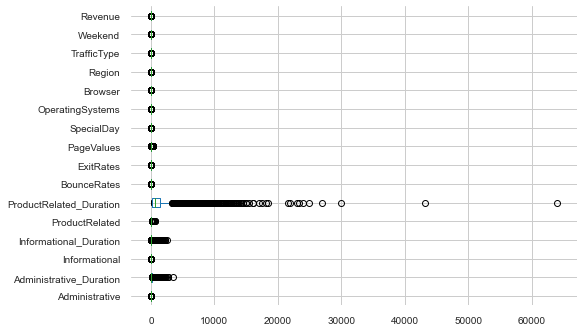

In [39]:
#checking for outliers
df.boxplot(vert=False)

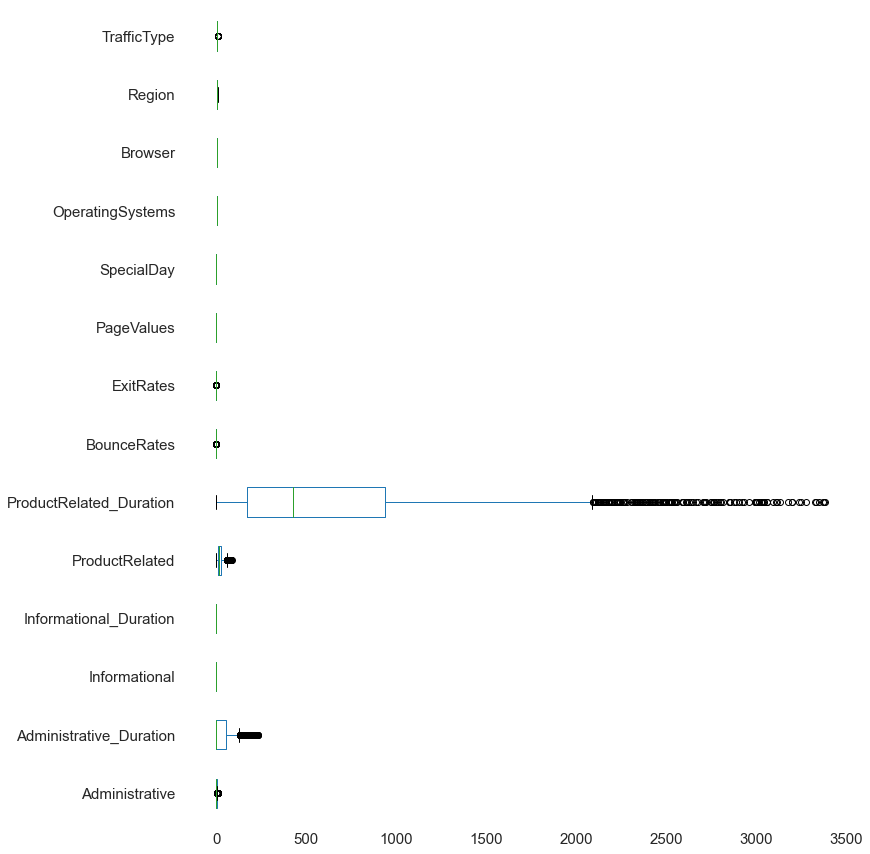

In [40]:
#removing out liers
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)

IQR = Q3-Q1
df1 = df.select_dtypes(exclude=['object','bool'])

dfno = df1[~((df1 < (Q1 - 1.5 * IQR)) |(df1 > (Q3 + 1.5 * IQR))).any(axis=1)]

plot = dfno.boxplot(grid=False, vert=False,fontsize=15, figsize=(12,15))


In [35]:
dfno

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType
1,0,0.00,0,0.0,2,64.000000,0.000000,0.100000,0.0,0.0,2,2,1,2
5,0,0.00,0,0.0,19,154.216667,0.015789,0.024561,0.0,0.0,2,2,1,3
14,0,0.00,0,0.0,2,68.000000,0.000000,0.100000,0.0,0.0,3,2,3,3
18,0,0.00,0,0.0,2,32.000000,0.000000,0.100000,0.0,0.0,2,2,1,3
22,0,0.00,0,0.0,3,105.000000,0.000000,0.033333,0.0,0.0,3,2,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12309,3,54.00,0,0.0,20,262.900000,0.008333,0.055556,0.0,0.0,2,2,1,2
12310,1,5.00,0,0.0,21,411.083333,0.015789,0.016140,0.0,0.0,3,2,7,3
12320,0,0.00,0,0.0,8,143.583333,0.014286,0.050000,0.0,0.0,2,2,3,1
12322,6,76.25,0,0.0,22,1075.250000,0.000000,0.004167,0.0,0.0,2,2,4,2


In [41]:
df3 = dfno.join(df, how='left', lsuffix='_l')
df3.columns

Index(['Administrative_l', 'Administrative_Duration_l', 'Informational_l',
       'Informational_Duration_l', 'ProductRelated_l',
       'ProductRelated_Duration_l', 'BounceRates_l', 'ExitRates_l',
       'PageValues_l', 'SpecialDay_l', 'OperatingSystems_l', 'Browser_l',
       'Region_l', 'TrafficType_l', 'Administrative',
       'Administrative_Duration', 'Informational', 'Informational_Duration',
       'ProductRelated', 'ProductRelated_Duration', 'BounceRates', 'ExitRates',
       'PageValues', 'SpecialDay', 'Month', 'OperatingSystems', 'Browser',
       'Region', 'TrafficType', 'VisitorType', 'Weekend', 'Revenue'],
      dtype='object')

In [42]:
df4 = df3[['Administrative',
       'Administrative_Duration', 'Informational', 'Informational_Duration',
       'ProductRelated', 'ProductRelated_Duration', 'BounceRates', 'ExitRates',
       'PageValues', 'SpecialDay', 'Month', 'OperatingSystems', 'Browser',
       'Region', 'TrafficType', 'VisitorType', 'Weekend', 'Revenue']]

In [43]:
df4.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
1,0,0.0,0,0.0,2,64.000000,0.000000,0.100000,0.0,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
5,0,0.0,0,0.0,19,154.216667,0.015789,0.024561,0.0,0.0,Feb,2,2,1,3,Returning_Visitor,False,False
14,0,0.0,0,0.0,2,68.000000,0.000000,0.100000,0.0,0.0,Feb,3,2,3,3,Returning_Visitor,False,False
18,0,0.0,0,0.0,2,32.000000,0.000000,0.100000,0.0,0.0,Feb,2,2,1,3,Returning_Visitor,False,False
22,0,0.0,0,0.0,3,105.000000,0.000000,0.033333,0.0,0.0,Feb,3,2,1,5,Returning_Visitor,False,False


In [45]:
df4.describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType
count,2550.000000,2550.000000,2550.0,2550.0,2550.000000,2550.000000,2550.000000,2550.000000,2550.0,2550.0,2550.000000,2550.0,2550.000000,2550.000000
mean,1.387843,31.969461,0.0,0.0,19.481569,673.048209,0.006471,0.031479,0.0,0.0,2.287843,2.0,3.028235,2.390196
std,2.031473,50.566170,0.0,0.0,16.641521,688.760357,0.010464,0.023041,0.0,0.0,0.580419,0.0,2.203635,1.330565
min,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.000000,2.0,1.000000,1.000000
25%,0.000000,0.000000,0.0,0.0,7.000000,169.041667,0.000000,0.014286,0.0,0.0,2.000000,2.0,1.000000,1.000000
50%,0.000000,0.000000,0.0,0.0,14.000000,426.283333,0.000000,0.025000,0.0,0.0,2.000000,2.0,3.000000,2.000000
75%,2.000000,50.968750,0.0,0.0,27.000000,937.850906,0.010218,0.042857,0.0,0.0,3.000000,2.0,4.000000,3.000000
max,10.000000,231.750000,0.0,0.0,84.000000,3382.083333,0.041667,0.100000,0.0,0.0,4.000000,2.0,8.000000,7.000000


In [47]:
profile2 = ProfileReport(df4,title='report detail',explorative=True)
profile2